In [1]:
from bidder_Stats102 import Bidder as BayesEVBidder
from bidder_Stats101 import Bidder as BayesBidder
from bidder_Baseline import Bidder as BaseBidder
from bidder_expVal import Bidder as expValBidder
from bidder_incr import Bidder as incrBidder
from bidder_BB import Bidder as BBBidder
from bidder_HybEgPd import Bidder as HybEgPdBidder
from bidder_price_bid_diff import Bidder as PdBidder 
from bidder_eg import Bidder as EgBidder
from bidder_avg import Bidder as AvgBidder
from bidder_yurica102 import Bidder


import numpy as np
import matplotlib.pyplot as plt
import copy

%matplotlib inline


class User:
    """Class to represent a user with a secret probability of clicking on an ad"""
    total_users = 0
    def __init__(self):
        self.__probability = np.random.uniform()
        self.user_id = User.total_users
        User.total_users +=1

    @property
    def get_prob(self):
        """secret probability getter"""
        return self.__probability


    def __repr__(self):
        return "User #" +str(self.user_id)

    def __str__(self):
        return str("class with hidden probability")

    def show_ad(self):
        """Method that models user ad behavior. Returns True to represent 
        user clicking on ad False otherwise."""

        return np.random.choice([True,False], p = [self.__probability, 1-self.__probability])

class Auction:
    """users is expected to contain a list of all User objects. bidders is
     expected to conain a list of all Bidder objects"""
    round = 0
    def __init__(self, users, bidders):
        self.history = []
        self.users = users
        self.bidders = bidders
        self.starting_balances_ls = [0]*len(bidders)
        self.starting_bal = {} 
        for bid, dollars in zip(self.bidders,self.starting_balances_ls):
            self.starting_bal[bid] = dollars
        self.balances = self.starting_bal

    def balance_get(self):
        """returns balances for bidders as a dictionary"""
        return self.balances
    
    def balance_set(self,bidder,money_gained = 0, money_spent = 0):
        """sets balances for bidders in dictionary"""
        self.balances[bidder] += money_gained - money_spent
        
    def __repr__(self):
        return str("Class representing Auction game")

    def __str__(self):
        return self.__repr__()

    def execute_round(self):
        """Should execute all steps within a single round of the game."""
        chosen_user = np.random.choice(self.users)
        submitted_bids = []
        bidder_list = copy.copy(self.bidders)
        
        #check user balances to ensure no one is out
        for identity , money  in self.balances.items():                
            if money < -1000 and identity in bidder_list:
                bidder_list.remove(identity)

        #collect user bids
        for individual in bidder_list:
            submitted_bids.append((individual, individual.bid(chosen_user)))
        submitted_bids = sorted(submitted_bids, key = lambda x: (x[1]))     
        #check user bids are not negative
        valid_bids = list(filter(lambda x: (x[1]>=0),submitted_bids))

        #handle ties, equal chance at winning
        max_bid = valid_bids[-1][1]
        winners_list = list(filter(lambda x: x[1] == max_bid,valid_bids))
        
        winner = winners_list[np.random.choice(range(len(winners_list)))][0]
        
        #winner pays second place bid
        if len(valid_bids)>1:
            valid_bids.pop()
        cost_of_ad = valid_bids.pop()[1]

        #check if user clicked ad
        clicked = chosen_user.show_ad()

        #notify all bidders if they won and what winning price was
        #winning bidder told if user clicked
        for bid in self.bidders:
            if bid == winner:
                bid.notify(True,cost_of_ad,clicked)
            else:
                bid.notify(False,cost_of_ad,None)
        
        #increment winning bidder balance by 1 if user clicked.
        # Decrease balance by winning price.
        self.balance_set(winner,clicked,cost_of_ad)
        
        #update history of balances
        round_balances = [self.balances[buyer] for buyer in self.bidders]


        self.history.append(round_balances)

    def plot_history(self):
        """Visual of auction results"""
        plt.plot(self.history)
        plt.title('Balances')
        plt.xlabel('Round')
        plt.ylabel('total reward')
        plt.plot()



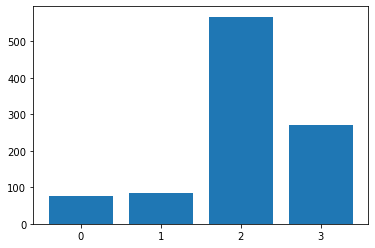

In [10]:

bidders = 4
simulations = 1000
scores_dict = {}
simulation_results = []
use_round = []
for i in range(bidders):
    scores_dict[i] = 0
    
for i in range (simulations):
    users = np.random.randint(1,50)
    rounds = np.random.randint(1,10000)
    use_round.append((users,rounds))
    
    b0 = Bidder(users,rounds)
    b1 = BaseBidder(users,rounds)
    b2 = incrBidder(users,rounds)
    b3 = AvgBidder(users,rounds)
    b4 = AvgBidder(users,rounds)
    b5 = EgBidder(users,rounds)
    b6 = PdBidder(users,rounds)
    b7 = BBBidder(users,rounds)
    b8 = expValBidder(users,rounds)
    b9 = BayesBidder(users,rounds)
    b10 = BayesEVBidder(users,rounds)
    
    
    bidder_list = [b3,b4,b9,b10]
    

    
    u0, u1, u2,u3, u4, u5, u6, u7, u8, u9 = User(), User(), User(), User(), User(),User(), User(), User(), User(), User()
    u10, u11, u12,u13, u14, u15, u16, u17, u18, u19 = User(), User(), User(), User(), User(),User(), User(), User(), User(), User()
    u20, u21, u22,u23, u24, u25, u26, u27, u28, u29 = User(), User(), User(), User(), User(),User(), User(), User(), User(), User()
    u30, u31, u32,u33, u34, u35, u36, u37, u38, u39 = User(), User(), User(), User(), User(),User(), User(), User(), User(), User()
    u40, u41, u42,u43, u44, u45, u46, u47, u48, u49 = User(), User(), User(), User(), User(),User(), User(), User(), User(), User()


    user_list = [u0,u1,u2,u3,u4,u5,u6,u7,u8,u9\
                ,u10,u11,u12,u13,u14,u15,u16,u17,u18,u19,\
                u20, u21, u22,u23, u24, u25, u26, u27, u28, u29,\
                u30, u31, u32,u33, u34, u35, u36, u37, u38, u39,\
                u40, u41, u42,u43, u44, u45, u46, u47, u48, u49]
    
    auction = Auction(user_list[:users],bidder_list[:bidders])
    for i in range (rounds):
        auction.execute_round()
        bal = auction.balances
        
    simulation_results.append(np.array(auction.history))
    
    final_scores = list(enumerate(auction.history[-1]))
    w_score = max(auction.history[-1])
    winners = list(filter(lambda x : x[1] == w_score, final_scores))
    
    for a,_ in winners:
        scores_dict[a] +=1

names = list(scores_dict.keys()) 
values = list(scores_dict.values()) 


plt.bar(range(len(scores_dict)), values, tick_label=names)
plt.show()

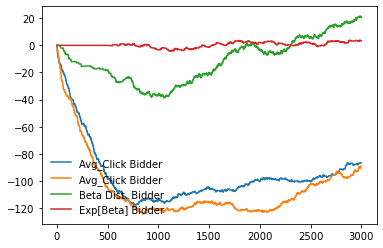

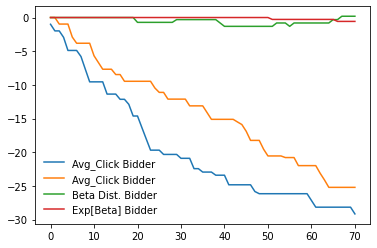

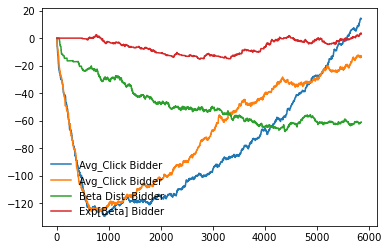

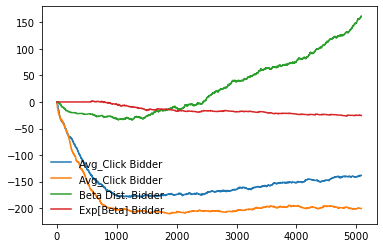

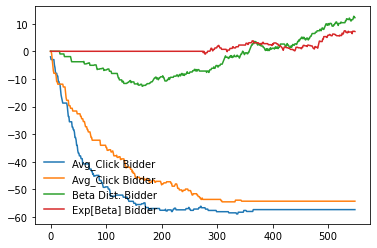

...

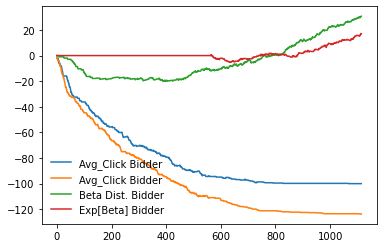

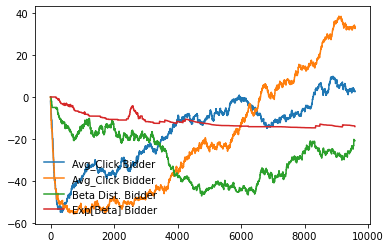

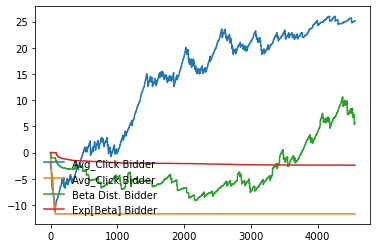

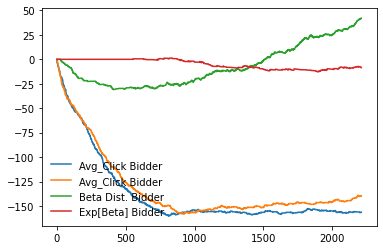

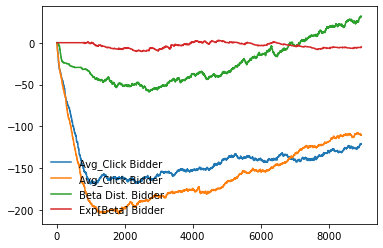

In [11]:
for i in simulation_results:
    lines = plt.plot(i)
    plt.legend(lines, bidder_list, loc = 'lower left', frameon = False);
    plt.show()


In [ ]:
for i in range(len(auction.history)):
    
    plt.bar(range(len(scores_dict)), auction.history[i], tick_label=names)
    plt.show()
